## **¿Qué es SSD?**

[Enlace al paper original](https://www.cs.utoronto.ca/~bonner/courses/2020s/csc2547/papers/discriminative/object-detection/ssd,-liu,-eccv-2016.pdf)

**SSD (Single Shot MultiBox Detector)** esun modelo avanzado de detección de objetos diseñado para proporcionar una combinación de precisión y velocidad.

SSD pertenece a la familia de **modelos de detección de una sola etapa**, lo que implica que realiza tanto la predición de las bounding boxes como la clasificación de los objetos en una única pasada a través de la red. Esto lo diferencia de modelos de dos etapas, como Faster R-CNN, que generan propuestas iniciales y posteriormente refinan las predicciones en una segunda fase.

### **Principios de funcionamiento**

1. **Detección en una sola etapa**

  SSD fusiona la detección de bounding boxes y la clasificación en una única operación.

  Para ello, utiliza directamente los mapas de características extraídos del backbone de la red y realiza predicciones en múltiples niveles, optimizando tanto la rapidez como la simplicidad arquitectónica.

  <font color = grey> Nota: Backbone → Parce central de una Neural Network encargada de extraer representaciones jerárquicas y significativas de los datos de entrada, generalmente mediante capas convolucionales. </font>

2. **Predicciones multiescala:**

  Una de las características distintivas de SSD es el uso de múltiples mapas de características a diferentes escalas para detectar objetos de diferentes tamaños. Esto se logra extendiendo el backbone con capas convolucionales adicionales que disminuyen progresivamente la resolución espacial.
  Las capas con resoluciones más altas detectan objetos pequeños, mientras que las capas de menor resolución manejan objetos más grandes.

3. **Cajas delimitadoras**

  En cada ubicación del mapa de característicaas, SSD genera un conjunto de cajas predeterminadas con diferentes tamaños, relaciones de aspecto y posiciones iniciales. Estas cajas actúan como hipótesis iniciales para las detecciones.

  Durante el entrenamiento, las cajas predeterminadas se ajustan para coincidir con los objetos reales en las imagenes mediante la predicción de desplazamientos y escalas.

4. **Regresión y clasificación conjunta**

  Para cada caja predeterminada, SSD predice:

    - Las coordenadas ajustadas de la bounding box
    - Las puntuaciones de confianza para cada clase de objeto

  Estas predicciones se realizan mediante capas convolucionales que aplican regresión para las coordenadas y clasificacioón para las clases.

5. **Mecanismo de pérdida**

  SSD utiliza una función de pérdida compuesta que combina:

    - *Smooth L1 loss* para los desplazamientos de las cajas predichas
    - *Categorical cross-entropy* para la clasificación

  Además, se implementa una estrategia de hard negative mining para equilibrar el sesgo inherente de las clases, debido a la gran cantidad de cajas predeterminadas negativas (sin objetos).
  
Imagen comparativa entre YOLO y SSD del paper original [Enlace al paper original](https://www.cs.utoronto.ca/~bonner/courses/2020s/csc2547/papers/discriminative/object-detection/ssd,-liu,-eccv-2016.pdf)

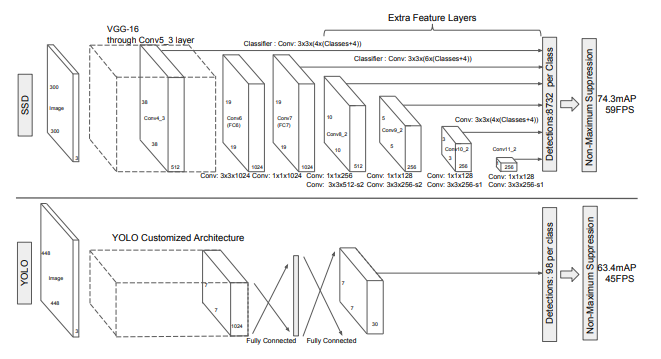

In [1]:
########################################
# IMPORTS
########################################
import os
import torch
import xml.etree.ElementTree as ET
from PIL import Image
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models.detection import ssd300_vgg16, SSD300_VGG16_Weights
from torchvision.models.detection.ssdlite import SSDLiteClassificationHead
import torch.optim as optim
from functools import partial
from torchvision.models.detection import _utils as det_utils
import torch.nn as nn
import matplotlib.patches as patches
from torchvision.transforms.functional import to_pil_image
import shutil
import os
from PIL import Image, ImageDraw
import xmltodict
from glob import glob
import cv2
from torchvision.transforms import functional as F
import random
import math
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
import pandas as pd
import numpy as np
from torch.cuda.amp import GradScaler, autocast

# **Preparar datos**
Definimos los paths de nuestros datos

In [2]:
test_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/test'
train_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/train'
valid_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/valid'

Visualizamos una imagen y una etiqueta para ver si hemos cargado adecuadamente los datos

Image path ==> /mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/train/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg
Label path ==> /mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/train/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.xml


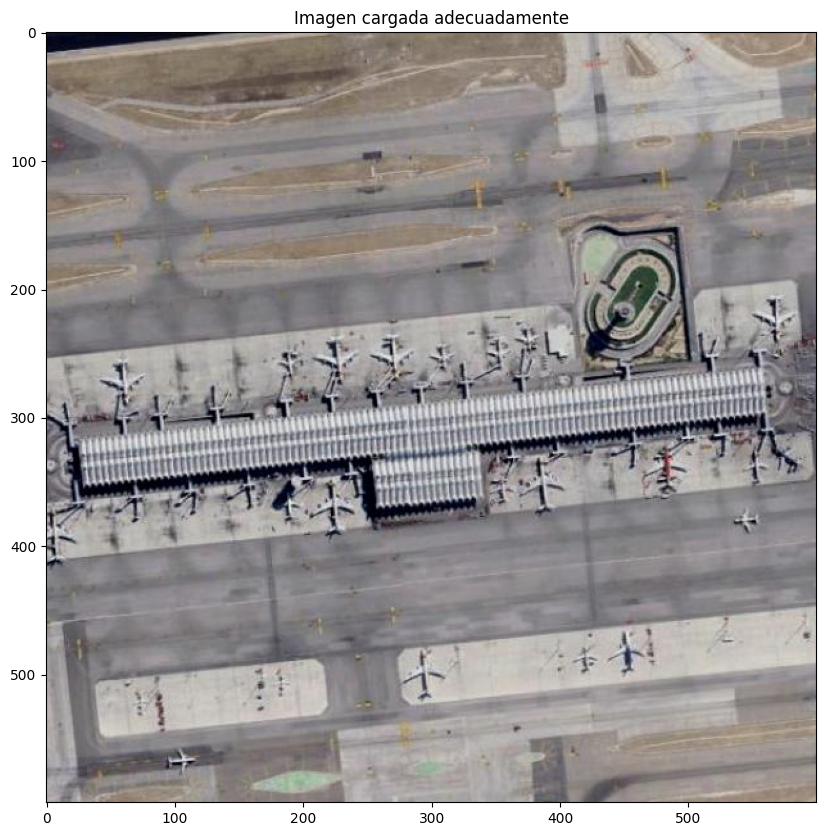

<annotation>
	<folder></folder>
	<filename>airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg</filename>
	<path>airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg</path>
	<source>
		<database>roboflow.ai</database>
	</source>
	<size>
		<width>600</width>
		<height>600</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>airplane</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<occluded>0</occluded>
		<bndbox>
			<xmin>551</xmin>
			<xmax>587</xmax>
			<ymin>205</ymin>
			<ymax>243</ymax>
		</bndbox>
	</object>
	<object>
		<name>airplane</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<occluded>0</occluded>
		<bndbox>
			<xmin>534</xmin>
			<xmax>558</xmax>
			<ymin>368</ymin>
			<ymax>396</ymax>
		</bndbox>
	</object>
	<object>
		<name>airplane</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<occluded>0</occluded>
		<bndbox>
			

In [3]:
image_path = train_data + '/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg'
label_path = train_data + '/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.xml'

print("Image path ==> " + image_path + "\nLabel path ==> " + label_path)

# Mostrar imagen
img = Image.open(image_path)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title("Imagen cargada adecuadamente")
plt.show()

# Mostrar etiquetas
!cat {label_path}

Definimos una función para visualizar las imagenes con sus respectivas bounding boxes

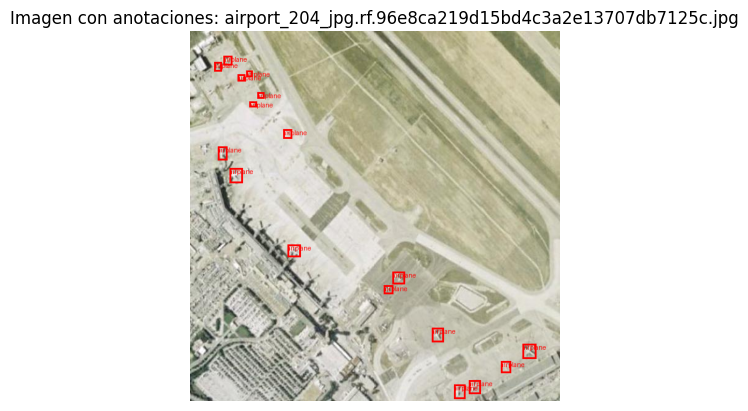

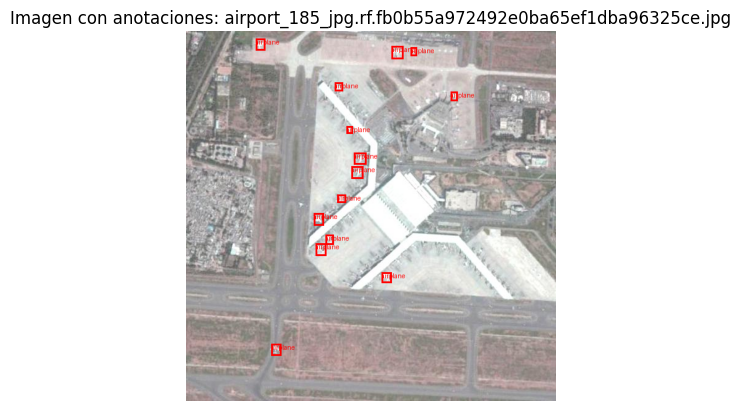

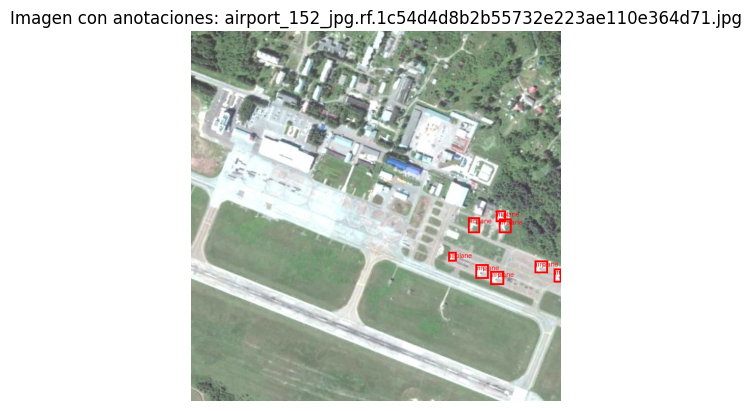

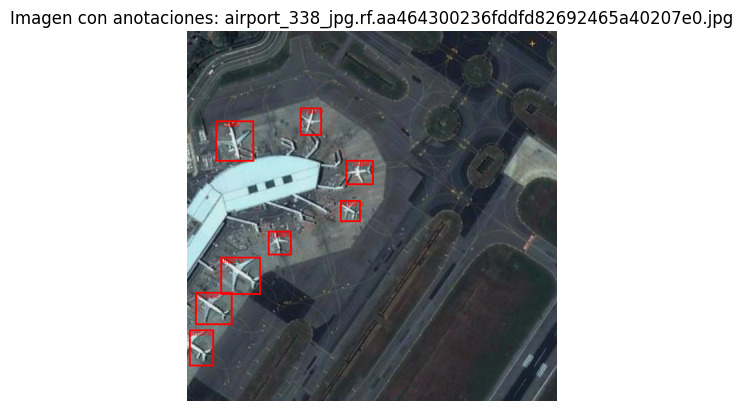

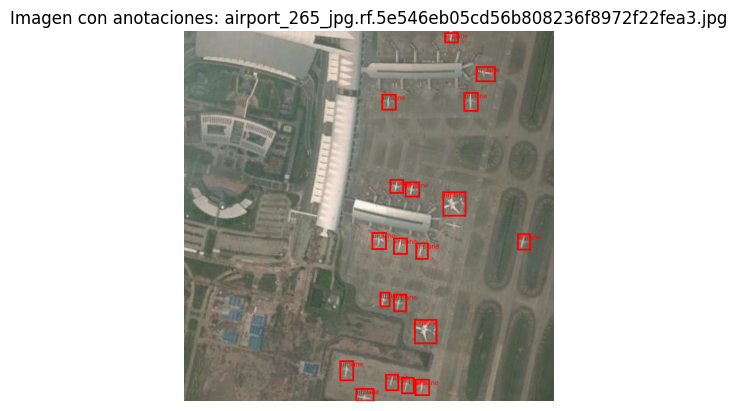

In [4]:
def visualizar_anotaciones(image_dir, num_imagenes):
    """
    Selecciona aleatoriamente un número de imágenes del directorio dado,
    dibuja las anotaciones (bounding boxes) sobre las imágenes y las muestra.
    
    Args:
    - image_dir (str): Ruta al directorio que contiene imágenes y etiquetas XML.
    - num_imagenes (int): Número de imágenes a seleccionar aleatoriamente.
    """
    # Obtener todas las imágenes del directorio
    image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
    
    # Seleccionar aleatoriamente imágenes
    seleccionadas = random.sample(image_files, min(num_imagenes, len(image_files)))
    
    for image_file in seleccionadas:
        # Ruta de la imagen
        image_path = os.path.join(image_dir, image_file)
        img = Image.open(image_path)
        
        # Ruta del archivo XML correspondiente
        annotation_file = os.path.join(image_dir, os.path.splitext(image_file)[0] + '.xml')
        
        # Verificar si la anotación existe antes de intentar procesarla
        if not os.path.exists(annotation_file):
            print(f"Anotación no encontrada para {image_file}. Saltando...")
            continue
        
        # Parsear el archivo XML
        tree = ET.parse(annotation_file)
        root = tree.getroot()
        
        # Dibujar las bounding boxes
        draw = ImageDraw.Draw(img)
        for obj in root.findall('object'):
            label = obj.find('name').text
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            
            # Dibujar la caja y añadir el label
            draw.rectangle([xmin, ymin, xmax, ymax], outline='red', width=3)
            draw.text((xmin, ymin), label, fill='red')
        
        # Mostrar la imagen con bounding boxes
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Imagen con anotaciones: {image_file}")
        plt.show()

# Ejemplo de uso
visualizar_anotaciones(train_data, 5)


Comprobamos que todas las etiquetas tengan aviones y vemos algunas métricas

In [5]:
def buscar_sin_aviones(xml_dir):
    """
    Busca archivos XML en un directorio que no contienen etiquetas de 'airplane'.
    
    Args:
    - xml_dir (str): Ruta al directorio que contiene los archivos XML.

    Returns:
    - List[str]: Lista de nombres de archivos XML que no contienen 'airplane'.
    """
    # Lista para almacenar los archivos sin etiquetas de 'airplane'
    sin_aviones = []

    # Obtener todos los archivos XML del directorio
    xml_files = [f for f in os.listdir(xml_dir) if f.endswith('.xml')]

    for xml_file in xml_files:
        xml_path = os.path.join(xml_dir, xml_file)

        # Parsear el archivo XML
        try:
            tree = ET.parse(xml_path)
            root = tree.getroot()

            # Verificar si hay algún objeto con la etiqueta 'airplane'
            tiene_avion = any(obj.find('name').text == 'airplane' for obj in root.findall('object'))

            if not tiene_avion:
                sin_aviones.append(xml_file)
        except ET.ParseError as e:
            print(f"Error al parsear {xml_file}: {e}")
    
    # Imprimir resultados
    print(f"Archivos sin etiquetas de 'airplane': {len(sin_aviones)}")
    for archivo in sin_aviones:
        print(f" - {archivo}")

    return sin_aviones

# Ejemplo de uso

print("\nEn train: \n")
sin_aviones_train = buscar_sin_aviones(train_data)
print("\nEn valid: \n")
sin_aviones_valid = buscar_sin_aviones(valid_data)

print("\nEn test\n")
sin_aviones_test = buscar_sin_aviones(test_data)



En train: 



Archivos sin etiquetas de 'airplane': 9
 - airport_177_jpg.rf.b81d4e0b59a6f9adcc1bb7a6fc4d339d.xml
 - airport_76_jpg.rf.73b87ee641eb9762b3b091c88116a71f.xml
 - airport_76_jpg.rf.834c0cc4fd113a5d3ac0c816315de18a.xml
 - airport_177_jpg.rf.5b5ae1b15ed06a9db568ceef51a45392.xml
 - airport_168_jpg.rf.7b2cf5d9c2b4aa8033cd40c42366f6eb.xml
 - airport_168_jpg.rf.29aa26edcfade11c9310bc71672bb435.xml
 - airport_177_jpg.rf.e7a1df01d7f66ffc82ffb0afbf07c404.xml
 - airport_76_jpg.rf.419becaa0edc8d9429e9babd6316f8f5.xml
 - airport_168_jpg.rf.62886a19b6e8b100a2b96e8c7b592a6e.xml

En valid: 

Archivos sin etiquetas de 'airplane': 2
 - airport_155_jpg.rf.ed5244b7809a06b013e751e027ca87c7.xml
 - airport_175_jpg.rf.d2240a9175241ea32cfc84094ad78118.xml

En test

Archivos sin etiquetas de 'airplane': 0


Configuramos el dispositivo en el que se ejecutará el modelo de PyTorch (CPU o GPU).

Si hay una GPU disponible, la usamos para acelerar considerablemente el entrenamiento y la inferencia del modelo, ya que las GPUs están optimizadas para operaciones matriciales y tensores.

Si no hay GPUs, se ejecutará en CPU, aunque sea más lento.

In [6]:
########################################
# DISPOSITIVO
########################################
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


Definimos una clase personalizada para gestionar el dataset de imágenes y anotaciones (en formato XML), para que sea compatible con PyTorch y nuestro modelo.

En este caso estamos utilizando el formato Pascal VOC debido a su soporte nativo con la implementación de SSD en PyTorch que estamos utilizando

Por ello el objetivo de este apartado concretamente es: 
- Leer imágenes y sus anotaciones correspondientes
- Aplicar transformaciones opcionales y escalar las cajas delimitadoras
- Preparar los datos en tensores PyTorch (`img`, `targets`) listos para el entrenamiento

In [7]:
########################################
# DATASET
########################################
class CustomSSDDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transforms=None):
        self.root_dir = root_dir
        self.transforms = transforms
        self.image_files = sorted([f for f in os.listdir(root_dir) if f.endswith('.jpg')])
        
        # Verifica si faltan anotaciones XML
        for img_file in self.image_files:
            xml_file = os.path.splitext(img_file)[0] + '.xml'
            if not os.path.exists(os.path.join(root_dir, xml_file)):
                print(f"Advertencia: Falta archivo XML para {img_file}")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Carga la imagen
        img_filename = self.image_files[idx]
        img_path = os.path.join(self.root_dir, img_filename)
        xml_filename = os.path.splitext(img_filename)[0] + '.xml'
        xml_path = os.path.join(self.root_dir, xml_filename)
        img = Image.open(img_path).convert("RGB")  # Asegura que esté en RGB
        original_width, original_height = img.size

        # Procesa las anotaciones
        boxes, labels = self.parse_annotation(xml_path)
        
        # Aplica transformaciones y escala las cajas
        if self.transforms:
            img = self.transforms(img)
            scale_x = 600 / original_width
            scale_y = 600 / original_height
            boxes = [[xmin * scale_x, ymin * scale_y, xmax * scale_x, ymax * scale_y] for xmin, ymin, xmax, ymax in boxes]

        # Convierte las cajas y etiquetas a tensores
        if len(boxes) == 0:
            boxes_tensor = torch.zeros((0, 4), dtype=torch.float32)
            labels_tensor = torch.zeros((0,), dtype=torch.int64)
        else:
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
            labels_tensor = torch.tensor(labels, dtype=torch.int64)

        target = {"boxes": boxes_tensor, "labels": labels_tensor}
        return img, target

    def parse_annotation(self, xml_path):
        """
        Lee y procesa un archivo XML en formato Pascal VOC.
        """
        if not os.path.exists(xml_path):
            print(f"Advertencia: No se encontró el archivo XML: {xml_path}")
            return [], []

        boxes, labels = [], []
        tree = ET.parse(xml_path)
        root = tree.getroot()

        for obj in root.findall("object"):
            label_name = obj.find("name").text
            label = 1 if label_name == 'airplane' else 0  # Ajusta según las clases
            bndbox = obj.find("bndbox")
            xmin = float(bndbox.find("xmin").text)
            ymin = float(bndbox.find("ymin").text)
            xmax = float(bndbox.find("xmax").text)
            ymax = float(bndbox.find("ymax").text)
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(label)

        return boxes, labels


Visualizamos para comprobar que estamos cargando los datasets adecuadamente

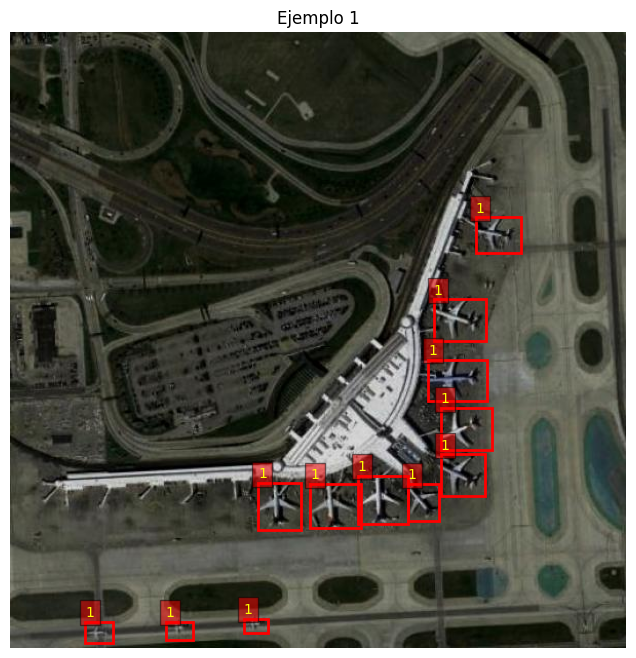

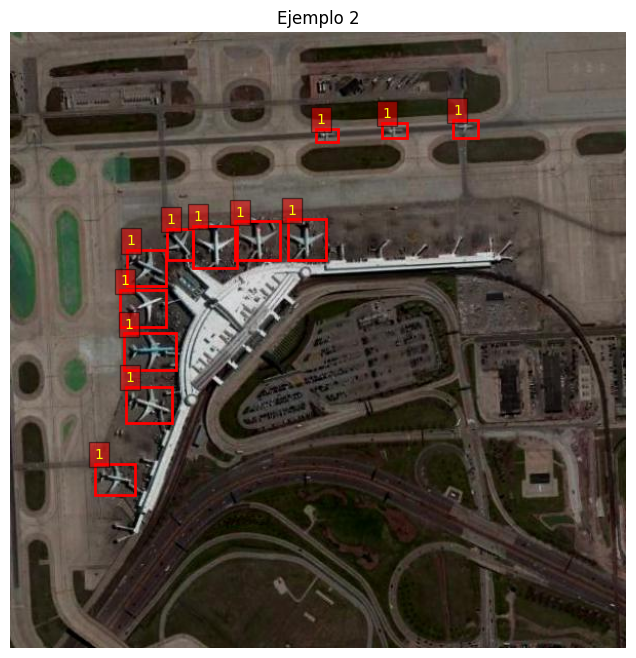

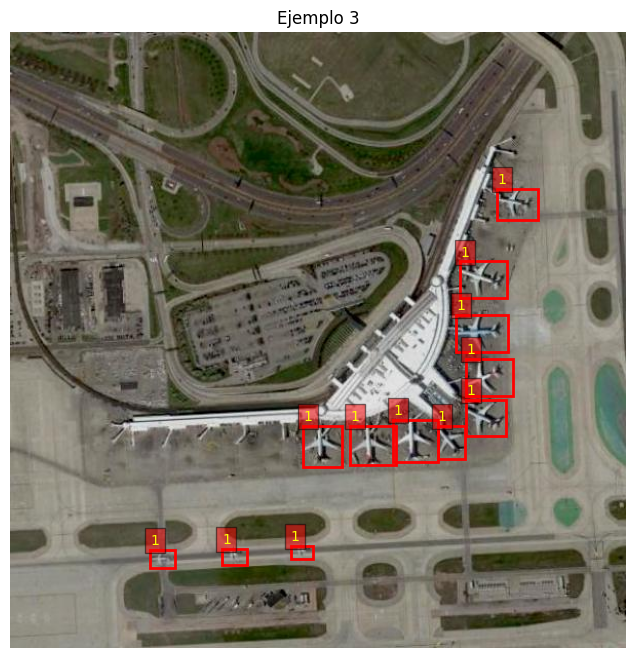

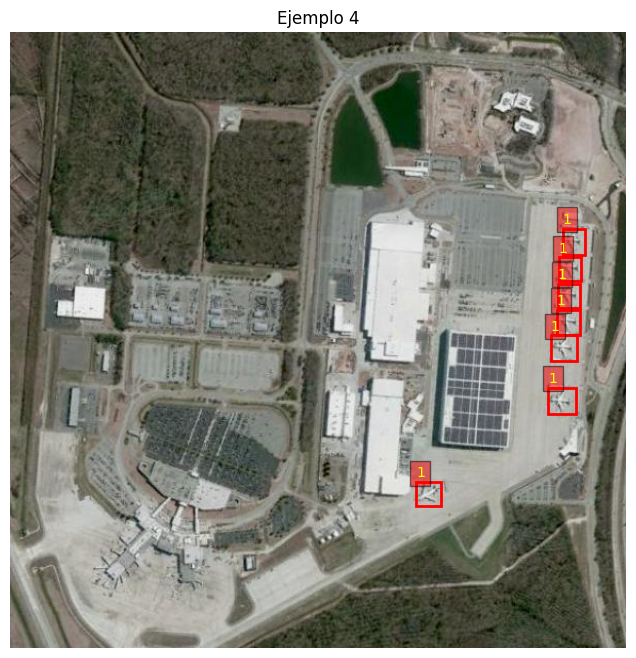

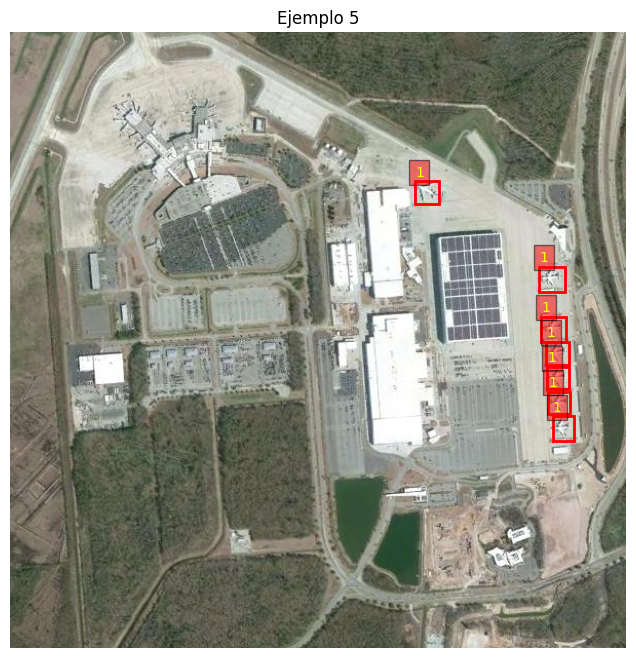

In [8]:
def visualize_dataset(dataset, num_examples=5):
    """
    Visualiza ejemplos del dataset con imágenes y cajas delimitadoras.
    
    Args:
        dataset: Instancia del dataset (CustomSSDDataset).
        num_examples: Número de ejemplos a visualizar.
    """
    for idx in range(num_examples):
        # Obtiene la imagen y las anotaciones
        img, target = dataset[idx]
        
        # Convierte el tensor de imagen a formato PIL si es necesario
        if isinstance(img, torch.Tensor):
            img = to_pil_image(img.clamp(0, 1))
        
        # Crea la figura para mostrar la imagen
        plt.figure(figsize=(8, 8))
        plt.imshow(img)

        # Extrae las cajas y etiquetas
        boxes = target["boxes"].numpy()
        labels = target["labels"].numpy()

        # Dibuja las cajas delimitadoras
        ax = plt.gca()
        for box, label in zip(boxes, labels):
            xmin, ymin, xmax, ymax = box
            rect = patches.Rectangle(
                (xmin, ymin), xmax - xmin, ymax - ymin,
                linewidth=2, edgecolor='red', facecolor='none'
            )
            ax.add_patch(rect)
            ax.text(xmin, ymin - 5, f"{label}", color="yellow", fontsize=10,
                    bbox=dict(facecolor="red", alpha=0.5))

        # Configuración final de la figura
        plt.axis("off")
        plt.title(f"Ejemplo {idx + 1}")
        plt.show()

########################################
# EJEMPLO DE USO
########################################
from torchvision import transforms

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

dataset = CustomSSDDataset('/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/train', transforms=data_transforms)
visualize_dataset(dataset, num_examples=5)


Pasamos a configurar las transformaciones de datos, los datasets y los DataLoaders, que son componentes clave para manejar y preparar los datos de manera eficiente durante el entrenamiento y validación.

1. **`collate_fn`**:  
   Combina los datos individuales (imagen y anotaciones) de un batch en una estructura compatible con el modelo.  
   Tiene como entrada un batch (lista de tuplas (`img`, `target`)), donde la `img` es la imagen transformada y el `target` es un diccionario con `boxes` y `labels`.  
   Como salida, devuelve una tupla de listas, donde la primera lista contiene las imágenes y la segunda los targets.

   **Ejemplo**: 

   ```python
   batch = [(img1, target1), (img2, target2), (img3, target3)]
   collate_fn(batch)  # Devuelve ([img1, img2, img3], [target1, target2, target3])
   ```

2. **`normalize`** y **`data_transforms`**:
    Redimensionamos todas las imagenes a $600 \times 600$ píxeles para que el modelo las procese uniformemente (estamos utilizando en todos los modelos el mismo tamaño para hacer una comparativa más justa).

    Transformamos la imagen PIL (valores [0-255]) a un tensor PyTorch (valores [0-1]), para que PyTorch procese las imagenes.

    Además normalizamos a los valores estandar de ImageNet ya que al usar un modelo preentrenado (SSD con pesos de COCO) espera valores normalizados, por lo que de no hacerlo el rendimiento empeoraría.

In [9]:
########################################
# TRANSFORMS Y DATALOADERS
########################################
def collate_fn(batch):
    return tuple(zip(*batch))

# normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
    # normalize
])

train_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/train'
valid_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/valid'
test_data = '/mnt/homeGPU/azapata/ZapataComputerVision/content/Aerial-Airport-1/test'

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)

# Utilizamos el bach_size = 8 para que la comparativa sea justa con los otros modelos
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

In [10]:
########################################
# CARGAR / AJUSTAR SSD
########################################
# Cargamos el modelo preentrenado en el dataset COCO
weights = SSD300_VGG16_Weights.COCO_V1
model = ssd300_vgg16(weights=weights)

# Ajustamos el numero de clases
num_classes = 2
in_channels = det_utils.retrieve_out_channels(model.backbone, (600, 600))
num_anchors = model.anchor_generator.num_anchors_per_location()
norm_layer = partial(nn.BatchNorm2d, eps=0.001, momentum=0.03) # Batch norm (obliga la nueva classification Head)

model.head.classification_head = SSDLiteClassificationHead(
    in_channels,
    num_anchors,
    num_classes,
    norm_layer
)

for param in model.parameters():
    param.requires_grad = True

model.to(device)

SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

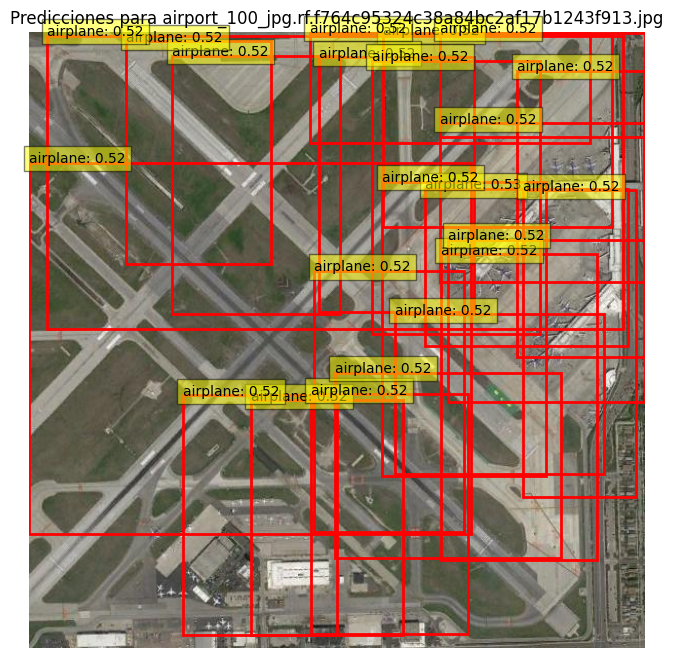

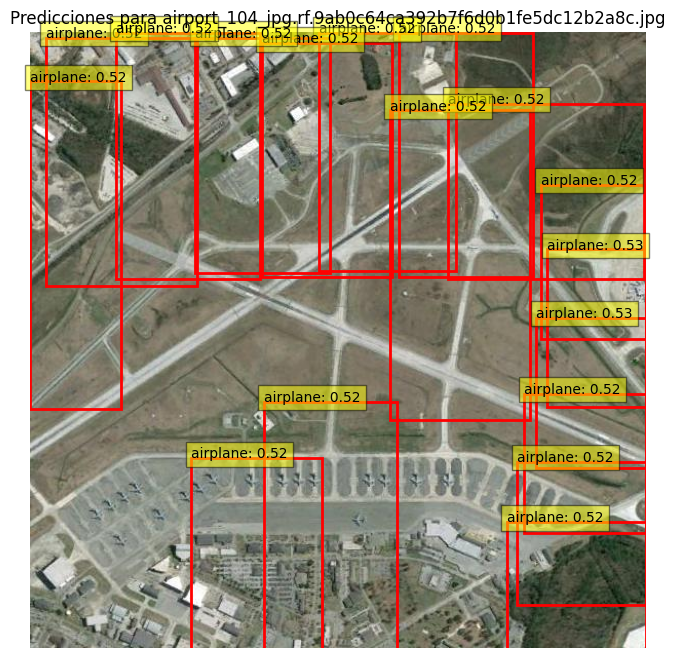

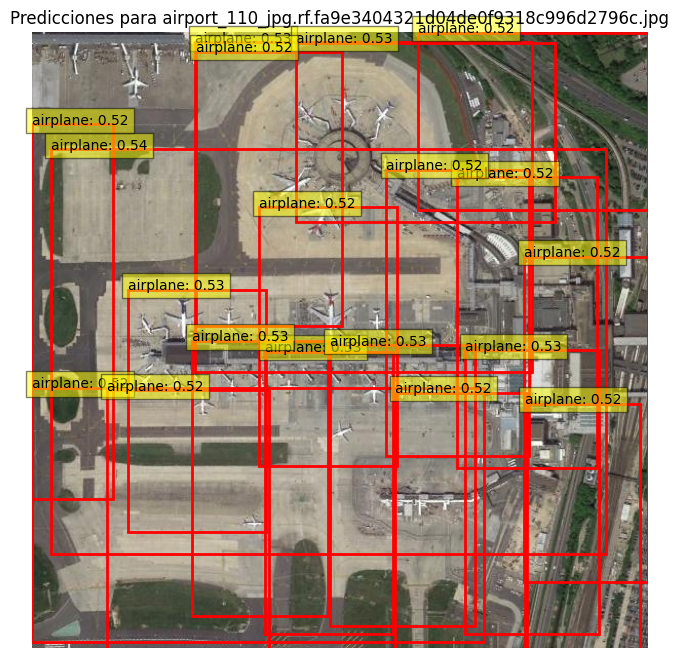

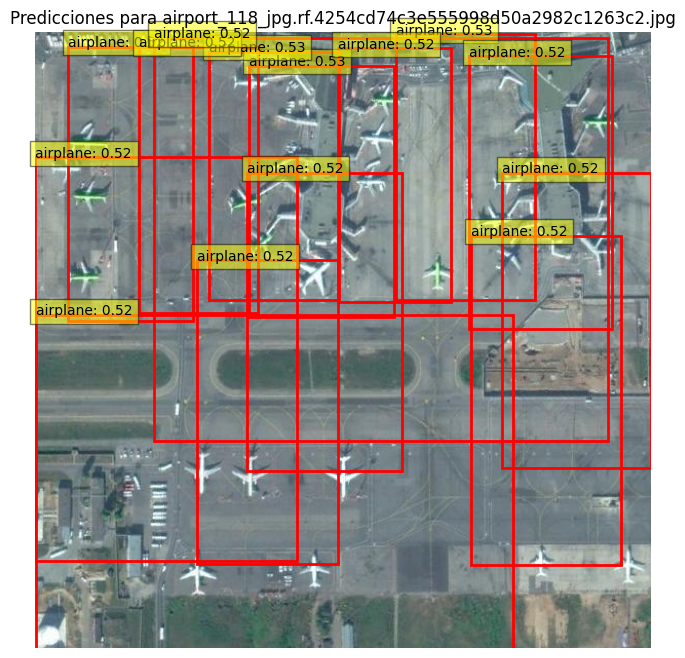

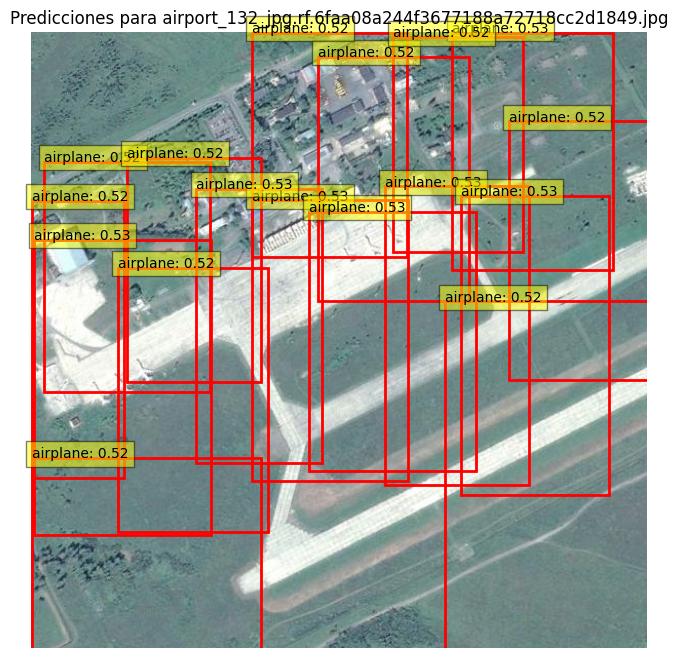

...

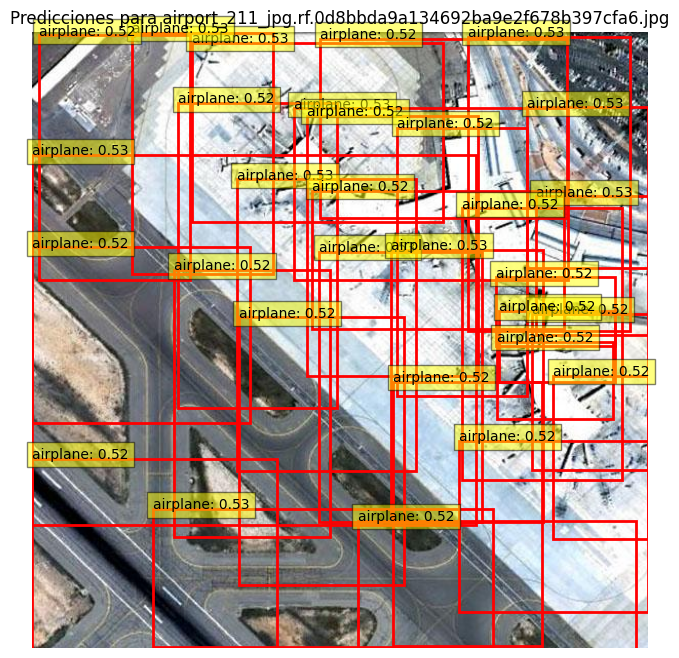

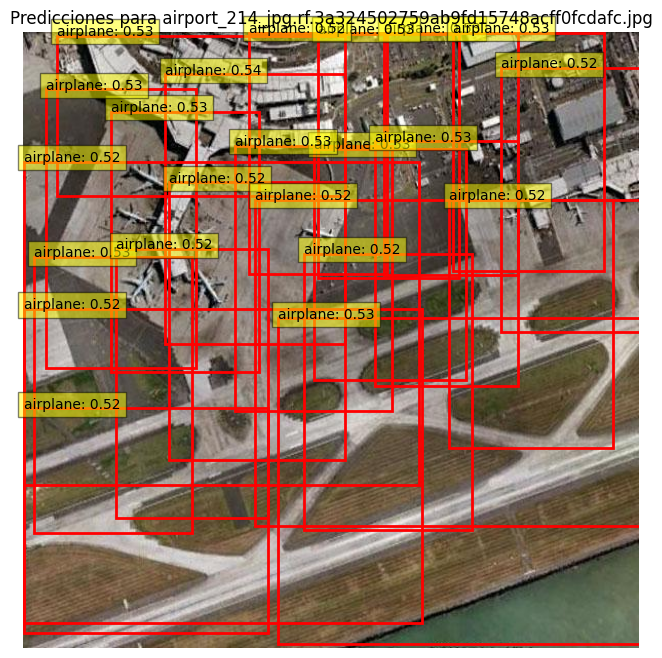

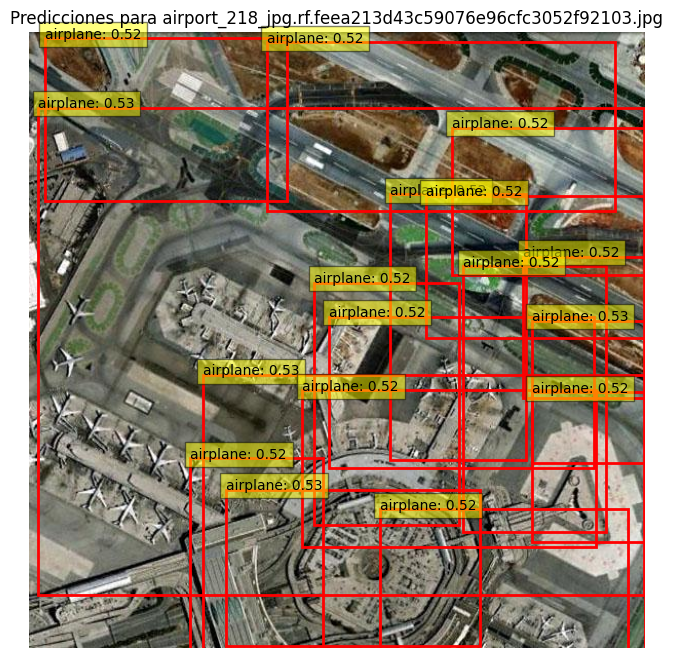

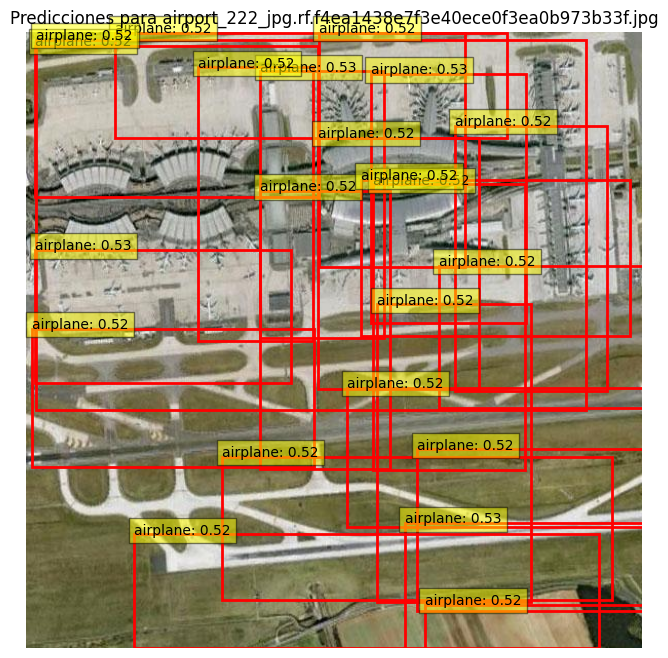

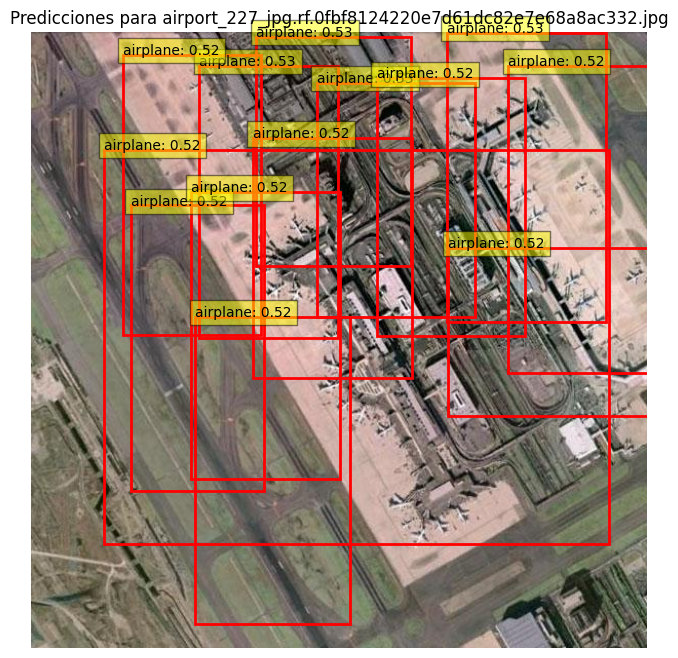

In [11]:
########################################
# INFERENCIA SIN ENTRENAMIENTO PREVIO
########################################
infer_transform = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
    # normalize
])

def infer_images(model, folder_path, device, num_images=1, score_threshold=0.3):
    model.eval()
    image_files = sorted([f for f in os.listdir(folder_path) if f.endswith('.jpg') or f.endswith('.png')])
    selected_images = image_files[:num_images]

    for img_file in selected_images:
        image_path = os.path.join(folder_path, img_file)
        image = Image.open(image_path).convert("RGB")
        original_width, original_height = image.size
        image_tensor = infer_transform(image).unsqueeze(0).to(device)

        model.eval()
        with torch.no_grad():
            predictions = model(image_tensor)

        boxes = predictions[0]["boxes"].cpu().numpy()
        labels = predictions[0]["labels"].cpu().numpy()
        scores = predictions[0]["scores"].cpu().numpy()

        scaled_boxes = []
        for box in boxes:
            xmin, ymin, xmax, ymax = box
            xmin *= original_width / 600
            ymin *= original_height / 600
            xmax *= original_width / 600
            ymax *= original_height / 600
            scaled_boxes.append([xmin, ymin, xmax, ymax])

        plt.figure(figsize=(8, 8))
        plt.imshow(image)
        ax = plt.gca()

        for box, label, score in zip(scaled_boxes, labels, scores):
            if score >= score_threshold:
                xmin, ymin, xmax, ymax = box
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=2)
                ax.add_patch(rect)
                text = f"airplane: {score:.2f}"
                ax.text(xmin, ymin, text, bbox=dict(facecolor="yellow", alpha=0.5))

        plt.axis("off")
        plt.title(f"Predicciones para {img_file}")
        plt.show()

test_folder_path = test_data
infer_images(model, test_folder_path, device, num_images=15, score_threshold=0.52)

Como se pueden observar, los resultados son realmente malos sin el entrenamiento previo

In [12]:
########################################
# ENTRENAMIENTO
########################################
def calc_iou_tensor(box1, box2):
    """Calculation of IoU based on two box tensors."""
    N = box1.size(0)
    M = box2.size(0)

    be1 = box1.unsqueeze(1).expand(-1, M, -1)
    be2 = box2.unsqueeze(0).expand(N, -1, -1)

    lt = torch.max(be1[:, :, :2], be2[:, :, :2])  # Left-Top
    rb = torch.min(be1[:, :, 2:], be2[:, :, 2:])  # Right-Bottom

    delta = rb - lt
    delta[delta < 0] = 0
    intersection = delta[:, :, 0] * delta[:, :, 1]

    delta1 = be1[:, :, 2:] - be1[:, :, :2]
    area1 = delta1[:, :, 0] * delta1[:, :, 1]
    delta2 = be2[:, :, 2:] - be2[:, :, :2]
    area2 = delta2[:, :, 0] * delta2[:, :, 1]

    union = area1 + area2 - intersection
    return intersection / (union + 1e-6)

/tmp/ipykernel_1512249/448712442.py:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)
/tmp/ipykernel_1512249/448712442.py:71: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/25] - Train Loss: 5.0780, Precision: 0.0426, Recall: 0.6230, Accuracy: 0.0413, F1-Score: 0.0798
Epoch [2/25] - Train Loss: 3.4079, Precision: 0.0534, Recall: 0.7512, Accuracy: 0.0521, F1-Score: 0.0997
Epoch [3/25] - Train Loss: 3.0008, Precision: 0.0597, Recall: 0.8217, Accuracy: 0.0585, F1-Score: 0.1112
Epoch [4/25] - Train Loss: 2.6749, Precision: 0.0612, Recall: 0.8269, Accuracy: 0.0601, F1-Score: 0.1140
Epoch [5/25] - Train Loss: 2.4575, Precision: 0.0601, Recall: 0.8278, Accuracy: 0.0590, F1-Score: 0.1120
Epoch [6/25] - Train Loss: 2.2741, Precision: 0.0610, Recall: 0.8267, Accuracy: 0.0599, F1-Score: 0.1136
Epoch [7/25] - Train Loss: 2.0517, Precision: 0.0626, Recall: 0.8360, Accuracy: 0.0614, F1-Score: 0.1164
Epoch [8/25] - Train Loss: 1.8779, Precision: 0.0625, Recall: 0.8541, Accuracy: 0.0615, F1-Score: 0.1164
Epoch [9/25] - Train Loss: 1.7470, Precision: 0.0608, Recall: 0.8439, Accuracy: 0.0598, F1-Score: 0.1134
Epoch [10/25] - Train Loss: 1.5531, Precision: 0.0585, 

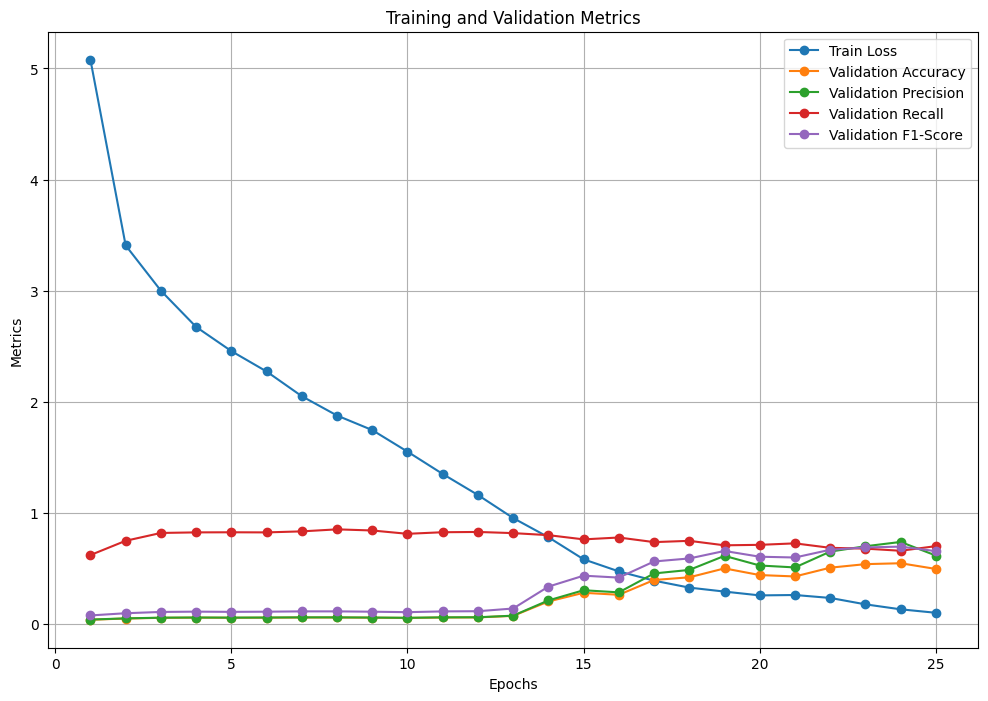

In [13]:
# Configuración inicial
num_epochs = 25
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.01,
    steps_per_epoch=len(train_loader),
    epochs=num_epochs,
)
scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)

# Para almacenar métricas
train_losses = []
val_accuracies = []
val_precisions = []
val_recalls = []
val_f1_metrics = []

model.train()

def calculate_metrics_with_iou(predictions, targets, iou_threshold=0.5):
    """Calcula precisión, recall y accuracy basados en IoU para las predicciones."""
    tp, fp, fn = 0, 0, 0

    for pred, tgt in zip(predictions, targets):
        pred_boxes = pred["boxes"]
        gt_boxes = tgt["boxes"]

        # Caso: No hay predicciones ni etiquetas
        if pred_boxes.numel() == 0 and gt_boxes.numel() == 0:
            continue

        # Caso: No hay predicciones
        if pred_boxes.numel() == 0:
            fn += len(gt_boxes)
            continue

        # Caso: No hay etiquetas
        if gt_boxes.numel() == 0:
            fp += len(pred_boxes)
            continue

        # Calcula IoU
        iou_matrix = calc_iou_tensor(pred_boxes, gt_boxes)

        # Match de IoUs mayores al umbral
        iou_matches = (iou_matrix >= iou_threshold).sum(dim=1)

        tp += (iou_matches > 0).sum().item()  # Detecciones correctamente hechas
        fp += (iou_matches == 0).sum().item()  # Predicciones no emparejadas
        fn += (iou_matrix.max(dim=0).values < iou_threshold).sum().item()  # Etiquetas no detectadas

    precision = tp / (tp + fp + 1e-6)
    recall = tp / (tp + fn + 1e-6)
    accuracy = tp / (tp + fp + fn + 1e-6)
    return precision, recall, accuracy

# Entrenamiento y Validación
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    # Entrenamiento
    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()

        # Mixed Precision
        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

        # Backpropagation y optimización
        scaler.scale(losses).backward()
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        scaler.step(optimizer)
        scaler.update()

        running_loss += losses.item()

    train_losses.append(running_loss / len(train_loader))

    # Validación
    model.eval()
    precision, recall, accuracy = 0, 0, 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)
            p, r, acc = calculate_metrics_with_iou(predictions, targets)
            precision += p
            recall += r
            accuracy += acc

    precision /= len(val_loader)
    recall /= len(val_loader)
    accuracy /= len(val_loader)
    f1_metric = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Logging
    val_precisions.append(precision)
    val_recalls.append(recall)
    val_accuracies.append(accuracy)
    val_f1_metrics.append(f1_metric)

    print(f"Epoch [{epoch + 1}/{num_epochs}] - "
          f"Train Loss: {train_losses[-1]:.4f}, "
          f"Precision: {precision:.4f}, "
          f"Recall: {recall:.4f}, "
          f"Accuracy: {accuracy:.4f}, "
          f"F1-Score: {f1_metric:.4f}")

# Gráficas del proceso de entrenamiento y validación
epochs = range(1, num_epochs + 1)

plt.figure(figsize=(12, 8))
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_accuracies, label='Validation Accuracy', marker='o')
plt.plot(epochs, val_precisions, label='Validation Precision', marker='o')
plt.plot(epochs, val_recalls, label='Validation Recall', marker='o')
plt.plot(epochs, val_f1_metrics, label='Validation F1-Score', marker='o')
plt.xlabel('Epochs')
plt.ylabel('Metrics')
plt.title('Training and Validation Metrics')
plt.legend()
plt.grid(True)
plt.show()


In [14]:
# Ruta donde deseas guardar el modelo
model_save_path = "/mnt/homeGPU/azapata/ZapataComputerVision/modelo_ssd.pth"

# Guarda el diccionario de parámetros del modelo
torch.save(model.state_dict(), model_save_path)
print(f"Modelo guardado en {model_save_path}")

Modelo guardado en /mnt/homeGPU/azapata/ZapataComputerVision/modelo_ssd.pth


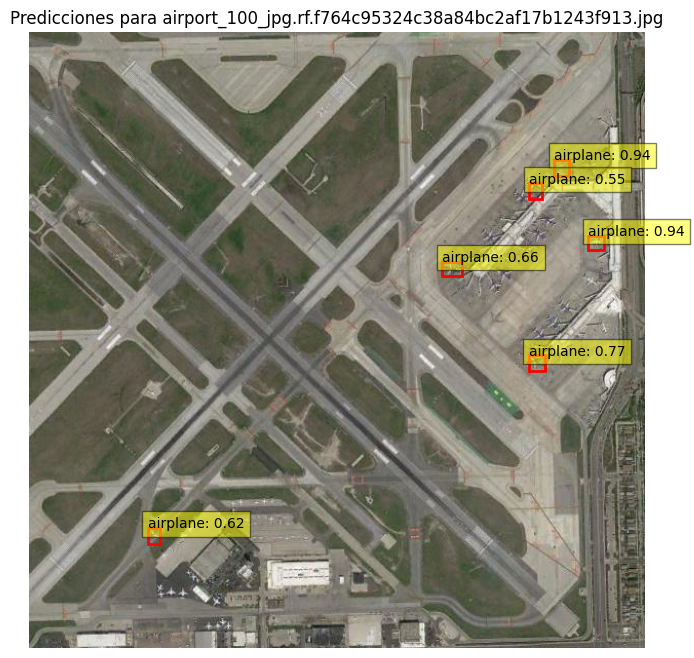

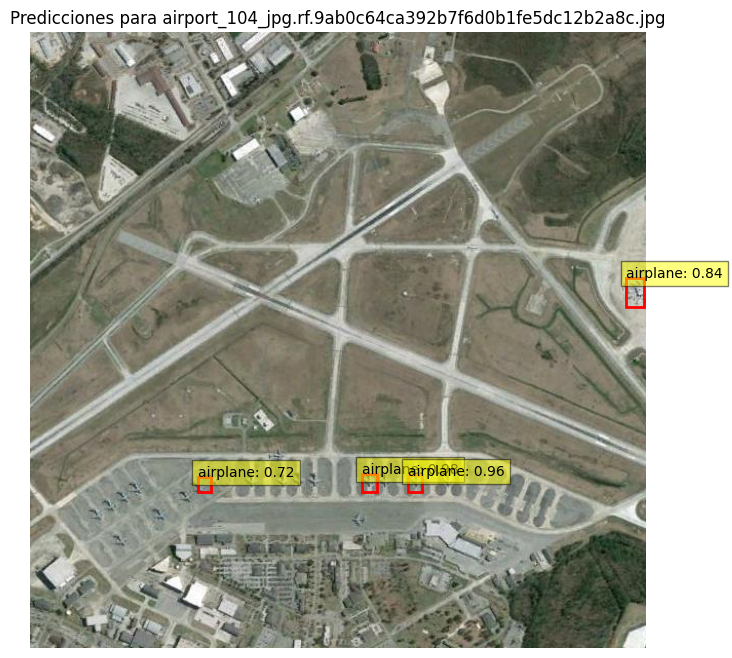

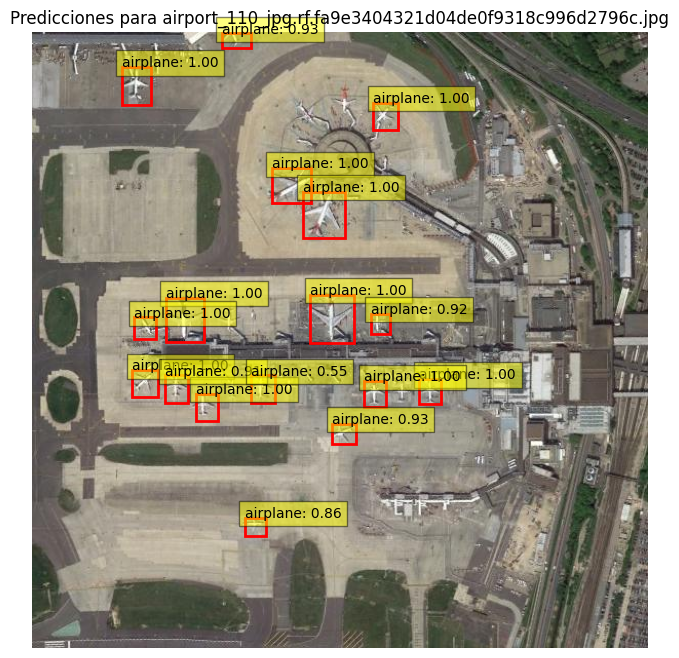

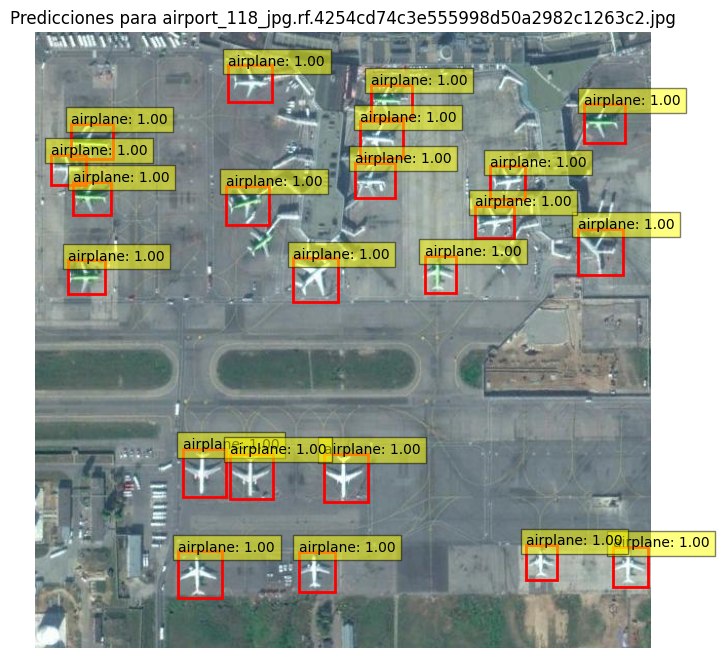

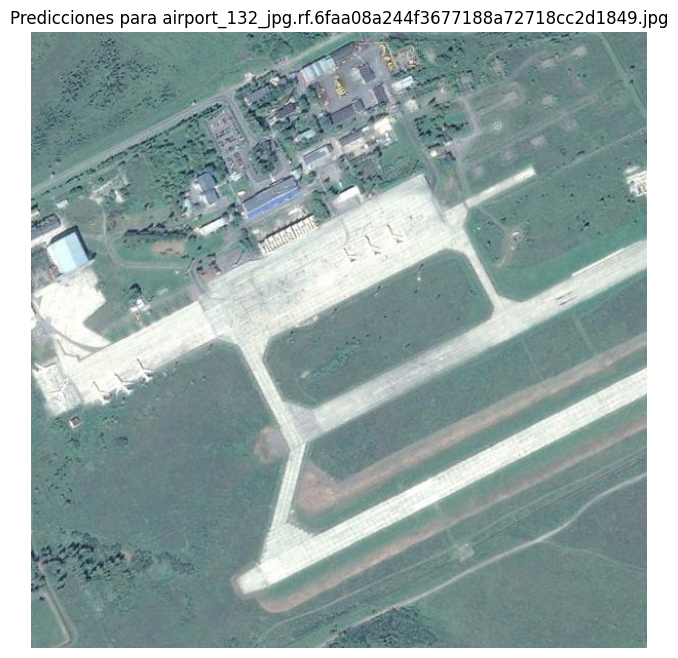

...

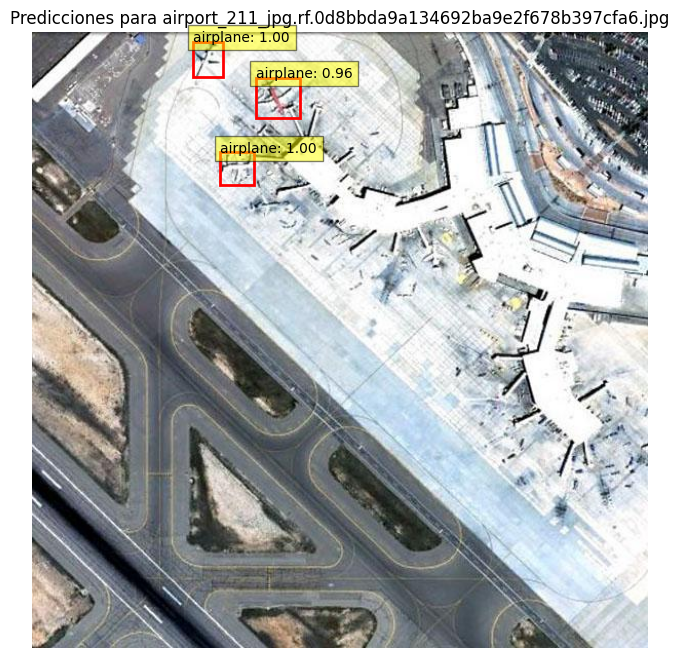

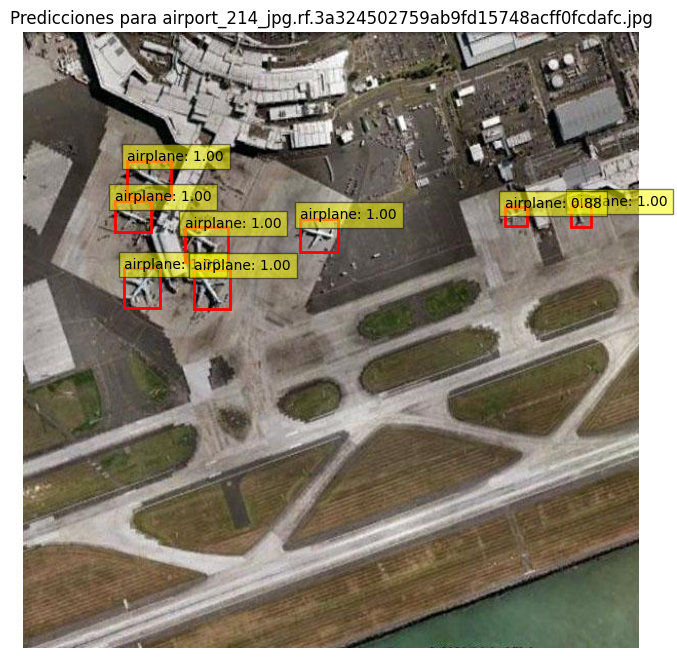

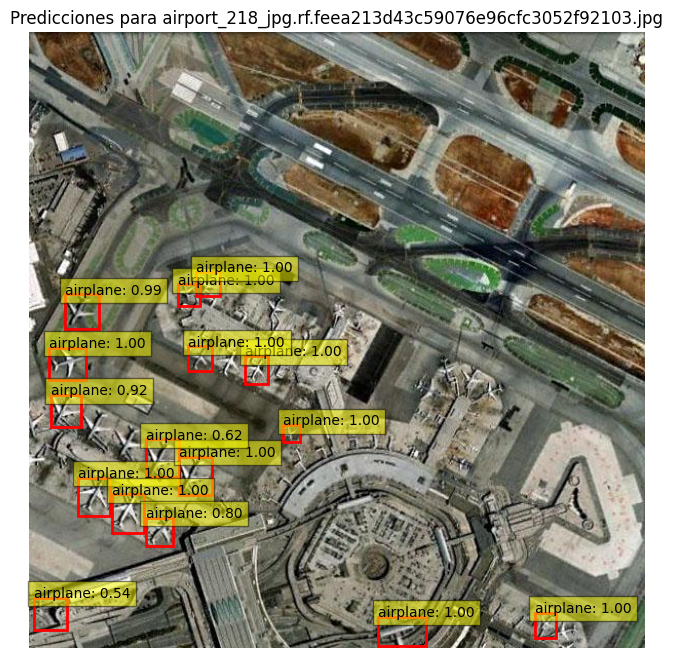

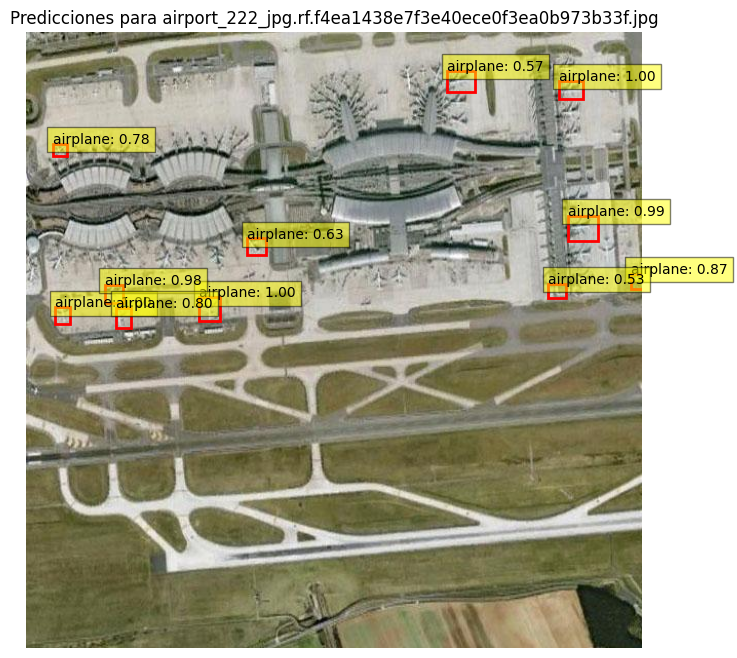

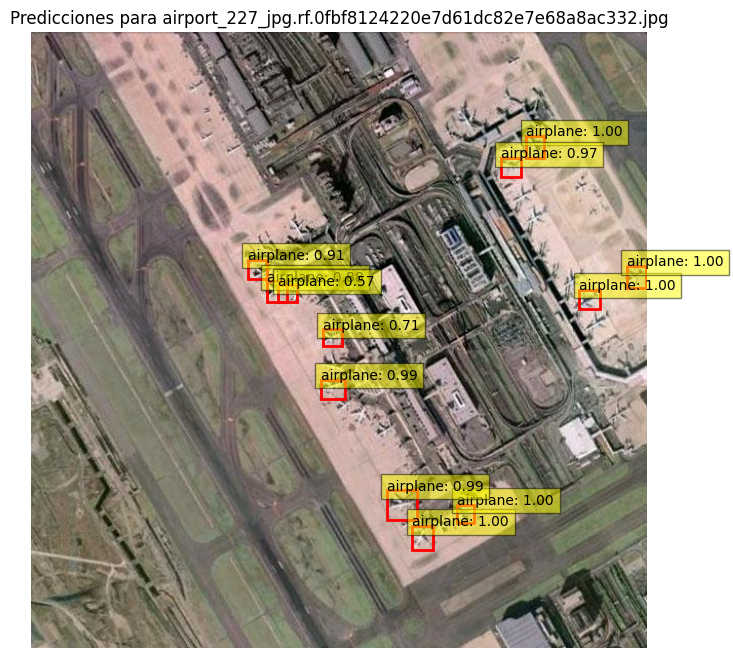

In [15]:
#############################################
# INFERENCIA TRAS ENTRENAMIENTO SIN DATA AUG
#############################################
test_folder_path = test_data
infer_images(model, test_folder_path, device, num_images=15, score_threshold=0.5)

# **Hallamos métricas**

In [16]:
def evaluate_model_on_dataloader(model, dataloader, device, iou_threshold=0.3, score_threshold=0.5):
    """
    Realiza inferencia y calcula métricas en un dataloader.
    """
    model.eval()
    all_true_labels = []
    all_pred_labels = []

    with torch.no_grad():
        for images, targets in dataloader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)

            for pred, tgt in zip(predictions, targets):
                pred_boxes = pred["boxes"].cpu().numpy()
                pred_scores = pred["scores"].cpu().numpy()
                pred_labels = pred["labels"].cpu().numpy()

                gt_boxes = tgt["boxes"].cpu().numpy()
                gt_labels = tgt["labels"].cpu().numpy()

                # Filtrar predicciones por score_threshold
                valid_indices = pred_scores >= score_threshold
                pred_boxes = pred_boxes[valid_indices]
                pred_labels = pred_labels[valid_indices]

                # Calcular IoU
                iou_matrix = calc_iou_tensor(
                    torch.tensor(pred_boxes, dtype=torch.float32),
                    torch.tensor(gt_boxes, dtype=torch.float32),
                ).numpy()

                # Asociar predicciones a ground truths
                matched_gt = iou_matrix >= iou_threshold

                # Asegurar que la longitud coincida
                num_true = len(gt_labels)
                num_pred = len(pred_labels)
                
                if num_pred > num_true:
                    pred_labels = pred_labels[:num_true]
                elif num_pred < num_true:
                    pred_labels = list(pred_labels) + [-1] * (num_true - num_pred)

                # Guardar métricas
                all_true_labels.extend(gt_labels)
                all_pred_labels.extend(pred_labels)

    # Calcular métricas globales
    precision = precision_score(all_true_labels, all_pred_labels, average='macro', zero_division=0)
    recall = recall_score(all_true_labels, all_pred_labels, average='macro', zero_division=0)
    accuracy = accuracy_score(all_true_labels, all_pred_labels)
    f1 = f1_score(all_true_labels, all_pred_labels, average='macro', zero_division=0)

    return {
        "precision": precision,
        "recall": recall,
        "accuracy": accuracy,
        "f1_score": f1,
    }

def evaluate_on_all_splits(model, train_loader, val_loader, test_loader, device):
    """
    Evalúa el modelo en los tres conjuntos (train, val, test) y devuelve métricas.
    """
    print("Evaluando en train...")
    train_metrics = evaluate_model_on_dataloader(model, train_loader, device)
    
    print("Evaluando en val...")
    val_metrics = evaluate_model_on_dataloader(model, val_loader, device)
    
    print("Evaluando en test...")
    test_metrics = evaluate_model_on_dataloader(model, test_loader, device)

    return {
        "train": train_metrics,
        "val": val_metrics,
        "test": test_metrics,
    }

def display_metrics(metrics_dict):
    """
    Muestra las métricas en un formato tabular más claro y organizado.
    """
    for split, metrics in metrics_dict.items():
        print(f"\nMetrics for {split.capitalize()} set:")
        df = pd.DataFrame([metrics])
        # Usar DataFrame.round directamente para redondear
        df = df.round(4)
        print(df.to_string(index=False))

# Ejecutar la evaluación y mostrar resultados
overall_metrics = evaluate_on_all_splits(model, train_loader, val_loader, test_loader, device)
display_metrics(overall_metrics)

Evaluando en train...


Evaluando en val...
Evaluando en test...

Metrics for Train set:
 precision  recall  accuracy  f1_score
       0.5  0.4845    0.9691    0.4921

Metrics for Val set:
 precision  recall  accuracy  f1_score
       0.5  0.2603    0.5206    0.3424

Metrics for Test set:
 precision  recall  accuracy  f1_score
       0.5  0.2636    0.5272    0.3452
